# Линейная регрессия

Данные содержатся в файле `data/lin_reg.txt`. Прочитать их можно следующим так:

In [1]:
import numpy as np
D = np.loadtxt('data/lin_reg.txt', delimiter=',')
X = D[:, :-1]
Y = D[:, -1]
print(X)
print(Y)

[[  9.31  -17.043  20.807  11.109]
 [ -6.446 -12.46  -12.941 -14.715]
 [ 14.324  -9.624  29.533   1.439]
 ...
 [  3.56    2.063   7.302  -7.817]
 [ 11.841 -14.315  23.148  11.777]
 [ -3.345 -15.219  -4.751  -1.141]]
[-165.864  -49.048 -161.183  177.828   40.092  132.818 -210.962  -11.84
  181.097  -28.715  -85.778   55.17   121.387   79.768   53.727   45.013
  -41.435  -91.088  129.3    138.069  -32.319  -93.994   54.087  -18.257
   78.758 -105.918   60.61  -113.481  122.498 -127.546   86.298   92.545
  144.638  -23.472   75.777  241.73   124.678  160.016 -218.938  -13.655
   80.752   32.972 -120.015  -52.363  109.309  -51.847   12.276  193.39
  200.685  215.559  169.829   16.579  145.243 -204.876   78.312  -10.712
 -144.72    82.893  -13.148  159.075 -185.267   84.177   35.619   30.017
 -118.21     6.077    4.829   31.069  -81.606  -43.921  -34.334  -32.272
  -40.123   62.691  -49.949   85.958   37.411    8.24  -156.191 -117.533
  -26.031   62.762 -146.486  -38.756  153.468  -37.562  

При выполнении заданий **нельзя** пользоваться `scikit-learn` и т.п., только `NumPy`/`JAX`/`TF`/`PyTorch` и `matplotlib`/`seaborn`/`plotly`/etc.

1. Нарисуйте график среднеквадратичной ошибки в зависимости от параметра регуляризации $\alpha$, используя полные данные для обучения и для тестирования. 
2. Подготовьте исходные данные для 5 fold CV.
3. С помощью CV найдите оптимальное значение $\alpha$ на какой-нибудь сетке значений.
4. Постройте валидационную кривую. 
5. Постройте кривую обучения.

Task 1
epoch 0, loss 11237.626953125
epoch 1, loss 11171.681640625
epoch 2, loss 11106.0283203125
epoch 3, loss 11040.6748046875
epoch 4, loss 10975.626953125
epoch 5, loss 10910.884765625
epoch 6, loss 10846.4580078125
epoch 7, loss 10782.3466796875
epoch 8, loss 10718.5576171875
epoch 9, loss 10655.095703125
epoch 10, loss 10591.962890625
epoch 11, loss 10529.1630859375
epoch 12, loss 10466.7001953125
epoch 13, loss 10404.5771484375
epoch 14, loss 10342.7978515625
epoch 15, loss 10281.365234375
epoch 16, loss 10220.2822265625
epoch 17, loss 10159.5478515625
epoch 18, loss 10099.1689453125
epoch 19, loss 10039.146484375
epoch 20, loss 9979.48046875
epoch 21, loss 9920.171875
epoch 22, loss 9861.2255859375
epoch 23, loss 9802.6416015625
epoch 24, loss 9744.41796875
epoch 25, loss 9686.55859375
epoch 26, loss 9629.064453125
epoch 27, loss 9571.9326171875
epoch 28, loss 9515.16796875
epoch 29, loss 9458.765625
epoch 30, loss 9402.73046875
epoch 31, loss 9347.0556640625
epoch 32, loss 929

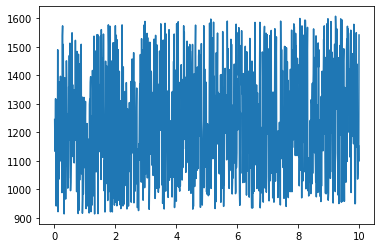

In [2]:
import torch
import matplotlib.pyplot as plt
from torch.autograd import Variable

#1
train_x = X.copy().reshape(-1, 4)
train_y = Y.copy().reshape(-1, 1)
x_data = torch.tensor(train_x).float()
y_data = torch.tensor(train_y).float()

 
loss_plot = []
decay_plot = []
 
class LinearRegressionModel(torch.nn.Module):
 
    def __init__(self):
        super(LinearRegressionModel, self).__init__()
        self.linear = torch.nn.Linear(4, 1)  
 
    def forward(self, x):
        y_pred = self.linear(x)
        return y_pred
 
for decay in range(1, 1000):
    our_model = LinearRegressionModel()
    
    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.Adam(our_model.parameters(), lr = 0.01, weight_decay = float(decay / 100))
    
    for epoch in range(500):
        optimizer.zero_grad()
        pred_y = our_model(x_data)
        loss = criterion(pred_y, y_data)
        loss.backward()
        optimizer.step()
        #print('epoch {}, loss {}'.format(epoch, loss.item()))
            
    with torch.no_grad():
        pred_y = our_model(x_data)
        loss = criterion(pred_y, y_data)
        loss_plot.append(loss)
        decay_plot.append(float(decay / 100))

plt.plot(decay_plot, loss_plot)




In [27]:
#2

k = 5
fold = [[train_x[0:200], train_y[0:200]], 
        [train_x[200:400], train_y[200:400]], 
        [train_x[400:600], train_y[400:600]], 
        [train_x[600:800], train_y[600:800]], 
        [train_x[800:-1], train_y[800:-1]]]

test_folds = []
for i in range(1, 5):
        test_folds.append(fold[i])
test_folds.append(fold[0])

train_folds = []
for i in range(0, 5):
        train_folds.append(fold[i])
        for j in range(0, 5):
                if j == i + 1 or (i == 4 and j == 0): continue
                train_folds[i].extend(fold[j])
print(len(train_folds))

5


In [35]:
#3
min_loss = 1000000000
best_decay = 0

for decay in range(0, 1000):
    our_model = LinearRegressionModel()
    
    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.Adam(our_model.parameters(), lr = 0.01, weight_decay = float(decay / 100))
    for fl in range(0, 5):
        
        x_data = torch.tensor(train_folds[fl][0]).float()
        y_data = torch.tensor(train_folds[fl][1]).float()

        for epoch in range(5):
            optimizer.zero_grad()
            pred_y = our_model(x_data)
            loss = criterion(pred_y, y_data)
            loss.backward()
            optimizer.step()

            print('epoch {}, loss {}'.format(epoch, loss.item()))

        x_test = torch.tensor(test_folds[fl][0]).float()
        y_test = torch.tensor(test_folds[fl][1]).float()
        with torch.no_grad():
            pred_y = our_model(x_test)
            loss = criterion(pred_y, y_test)
            if(min_loss > loss):
                min_loss = loss
                best_decay = float(decay / 100)
            
print('best decay is ', best_decay)

epoch 0, loss 12303.79296875
epoch 1, loss 12233.9375
epoch 2, loss 12164.3798828125
epoch 3, loss 12095.12890625
epoch 4, loss 12026.1875
epoch 0, loss 11352.365234375
epoch 1, loss 11285.3671875
epoch 2, loss 11218.7451171875
epoch 3, loss 11152.462890625
epoch 4, loss 11086.509765625
epoch 0, loss 10637.9677734375
epoch 1, loss 10579.642578125
epoch 2, loss 10521.763671875
epoch 3, loss 10464.30078125
epoch 4, loss 10407.2353515625
epoch 0, loss 9251.0322265625
epoch 1, loss 9201.7421875
epoch 2, loss 9152.9384765625
epoch 3, loss 9104.576171875
epoch 4, loss 9056.6201171875
epoch 0, loss 12627.544921875
epoch 1, loss 12555.4775390625
epoch 2, loss 12482.328125
epoch 3, loss 12408.341796875
epoch 4, loss 12333.720703125
epoch 0, loss 13856.19140625
epoch 1, loss 13780.259765625
epoch 2, loss 13704.630859375
epoch 3, loss 13629.3095703125
epoch 4, loss 13554.3037109375
epoch 0, loss 12622.431640625
epoch 1, loss 12552.65625
epoch 2, loss 12482.62109375
epoch 3, loss 12412.5810546875


epoch 0, loss 12813.6171875
epoch 1, loss 12739.06640625
epoch 2, loss 12664.8212890625
epoch 3, loss 12590.8828125
epoch 4, loss 12517.259765625
epoch 5, loss 12443.955078125
epoch 6, loss 12370.97265625
epoch 7, loss 12298.3212890625
epoch 8, loss 12226.0
epoch 9, loss 12154.0146484375
epoch 10, loss 12082.369140625
epoch 11, loss 12011.06640625
epoch 12, loss 11940.107421875
epoch 13, loss 11869.4990234375
epoch 14, loss 11799.2421875
epoch 15, loss 11729.337890625
epoch 16, loss 11659.787109375
epoch 17, loss 11590.59375
epoch 18, loss 11521.7587890625
epoch 19, loss 11453.2802734375
epoch 20, loss 11385.162109375
epoch 21, loss 11317.4033203125
epoch 22, loss 11250.0029296875
epoch 23, loss 11182.962890625
epoch 24, loss 11116.28125
epoch 25, loss 11049.958984375
epoch 26, loss 10983.9951171875
epoch 27, loss 10918.3896484375
epoch 28, loss 10853.1416015625
epoch 29, loss 10788.25
epoch 30, loss 10723.7158203125
epoch 31, loss 10659.537109375
epoch 32, loss 10595.71484375
epoch 33

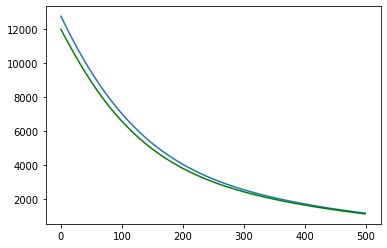

In [45]:
#4-5
train_loss_plot = []
valid_loss_plot = []

our_model = LinearRegressionModel()

criterion = torch.nn.MSELoss()
optimizer = torch.optim.Adam(our_model.parameters(), lr = 0.01, weight_decay = best_decay)
    
x_data = torch.tensor(train_folds[0][0]).float()
y_data = torch.tensor(train_folds[0][1]).float()

for epoch in range(500):
    optimizer.zero_grad()
    pred_y = our_model(x_data)
    loss = criterion(pred_y, y_data)
    loss.backward()
    optimizer.step()

    print('epoch {}, loss {}'.format(epoch, loss.item()))
    with torch.no_grad():
        pred_y = our_model(x_data)
        loss = criterion(pred_y, y_data)
        train_loss_plot.append(loss)
    x_test = torch.tensor(test_folds[0][0]).float()
    y_test = torch.tensor(test_folds[0][1]).float()
    with torch.no_grad():
        pred_y = our_model(x_test)
        loss = criterion(pred_y, y_test)
        valid_loss_plot.append(loss)
        if(min_loss > loss):
            min_loss = loss
            best_decay = float(decay / 100)



plt.plot(np.arange(0, len(train_loss_plot), 1), train_loss_plot)
plt.plot(np.arange(0, len(valid_loss_plot), 1), valid_loss_plot)
